In [1]:
import torch.nn as nn
import zipfile
from PIL import Image
import io
import torch
from torch.utils.data import Dataset
from torchvision import transforms
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
import torch.nn.init as init
import torch.nn.functional as F

Гиперпараметры

In [2]:

latent_dim = 100
channels = 3
image_size = 128
img_dim = channels * image_size * image_size
batch_size = 64
num_epochs = 300

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

Генератор

In [3]:
generator = nn.Sequential(
    nn.Linear(latent_dim, 256),
    nn.ReLU(True),
    nn.Linear(256, 512),
    nn.ReLU(True),
    nn.Linear(512, img_dim),
    nn.Tanh()
).to(device)

Дискриминатор

In [4]:
discriminator = nn.Sequential(
    nn.Linear(img_dim, 512),
    nn.LeakyReLU(0.2, inplace=True),
    nn.Dropout(0.3),
    nn.Linear(512, 256),
    nn.LeakyReLU(0.2, inplace=True),
    nn.Dropout(0.3),
    nn.Linear(256, 1),
    nn.Sigmoid()
).to(device)

Инициализация весов

In [5]:
def weights_init(m):
    if isinstance(m, nn.Linear):
        nn.init.normal_(m.weight, 0.0, 0.02)
        nn.init.constant_(m.bias, 0)
generator.apply(weights_init)
discriminator.apply(weights_init)

Sequential(
  (0): Linear(in_features=49152, out_features=512, bias=True)
  (1): LeakyReLU(negative_slope=0.2, inplace=True)
  (2): Dropout(p=0.3, inplace=False)
  (3): Linear(in_features=512, out_features=256, bias=True)
  (4): LeakyReLU(negative_slope=0.2, inplace=True)
  (5): Dropout(p=0.3, inplace=False)
  (6): Linear(in_features=256, out_features=1, bias=True)
  (7): Sigmoid()
)

Функции потерь и оптимизаторы

In [6]:
criterion = nn.BCELoss()
lr = 0.0003
optimizer_G = torch.optim.Adam(generator.parameters(), lr=lr, betas=(0.5, 0.999))
optimizer_D = torch.optim.Adam(discriminator.parameters(), lr=lr, betas=(0.5, 0.999))

Обработка данных

In [8]:
class ZipImageDataset(Dataset):
    def __init__(self, zip_path, image_size):
        self.zip_file = zipfile.ZipFile(zip_path)
        self.image_names = [name for name in self.zip_file.namelist() if name.lower().endswith(('.png', '.jpg', '.jpeg'))]
        self.transform = transforms.Compose([
            transforms.Resize(image_size),
            transforms.CenterCrop(image_size),
            transforms.ToTensor(),
            transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
        ])
    
    def __len__(self): return len(self.image_names)
    def __getitem__(self, idx):
        with self.zip_file.open(self.image_names[idx]) as f:
            img = Image.open(io.BytesIO(f.read())).convert("RGB")
        return self.transform(img)

dataset = ZipImageDataset("data/pizza.zip", image_size=image_size)
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True, drop_last=True)

fixed_z = torch.randn(16, latent_dim, device=device)

Генерация изображений

In [9]:
def generate_and_show(generator, fixed_z=None, n_images=16):
    generator.eval()
    with torch.no_grad():
        z = fixed_z[:n_images] if fixed_z is not None else torch.randn(n_images, latent_dim, device=device)
        fake_imgs = generator(z)
    fake_imgs = ((fake_imgs + 1) / 2).view(n_images, 3, image_size, image_size).permute(0, 2, 3, 1).cpu()
    grid = int(n_images ** 0.5)
    fig, axes = plt.subplots(grid, grid, figsize=(8, 8))
    for i in range(grid):
        for j in range(grid):
            axes[i, j].imshow(fake_imgs[i*grid + j])
            axes[i, j].axis("off")
    plt.tight_layout()
    plt.show()
    generator.train()

Обучение

[Epoch 1/300] [Batch 0] D: 0.7195 G: 125.2694 Real mean: -0.1300 Fake mean: 0.0001
Epoch 1 samples:


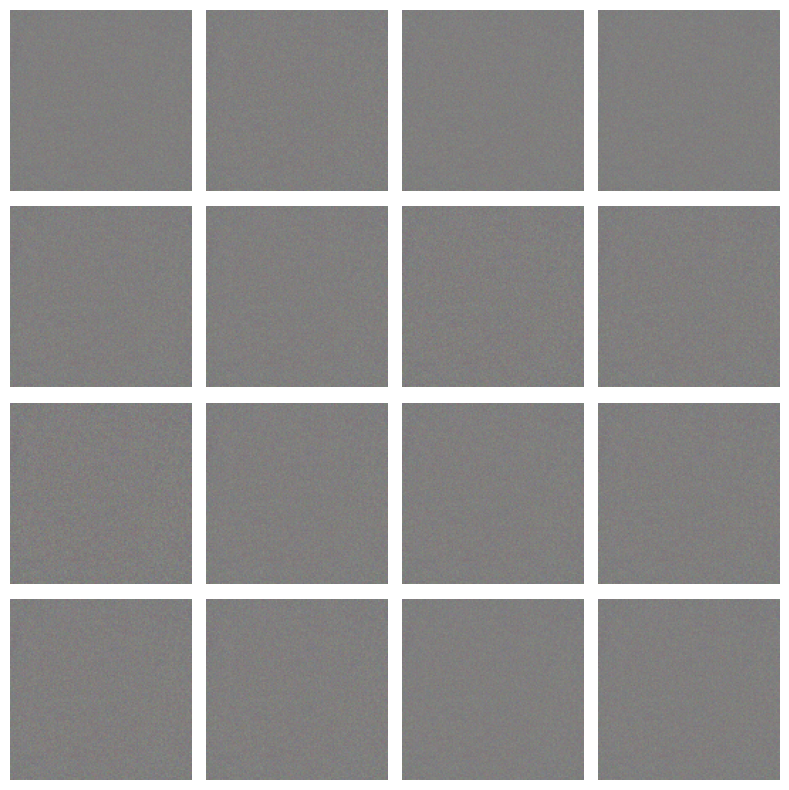

[Epoch 2/300] [Batch 0] D: 0.5102 G: 416.5719 Real mean: -0.1428 Fake mean: -0.0029
[Epoch 3/300] [Batch 0] D: 0.5386 G: 369.8132 Real mean: -0.1492 Fake mean: -0.0011
[Epoch 4/300] [Batch 0] D: 0.5185 G: 412.6600 Real mean: -0.1432 Fake mean: -0.0013
[Epoch 5/300] [Batch 0] D: 0.5127 G: 446.2210 Real mean: -0.1018 Fake mean: -0.0007
[Epoch 6/300] [Batch 0] D: 0.5172 G: 434.4709 Real mean: -0.1343 Fake mean: -0.0008
[Epoch 7/300] [Batch 0] D: 0.5076 G: 455.9916 Real mean: -0.1632 Fake mean: -0.0017
[Epoch 8/300] [Batch 0] D: 0.5051 G: 388.2372 Real mean: -0.1385 Fake mean: -0.0020
[Epoch 9/300] [Batch 0] D: 0.5139 G: 437.9220 Real mean: -0.1474 Fake mean: -0.0027
[Epoch 10/300] [Batch 0] D: 0.5023 G: 402.8146 Real mean: -0.1468 Fake mean: -0.0033
[Epoch 11/300] [Batch 0] D: 0.5019 G: 404.7221 Real mean: -0.1479 Fake mean: -0.0026
[Epoch 12/300] [Batch 0] D: 0.5030 G: 334.9171 Real mean: -0.1195 Fake mean: -0.0031
[Epoch 13/300] [Batch 0] D: 0.5047 G: 316.9048 Real mean: -0.1233 Fake me

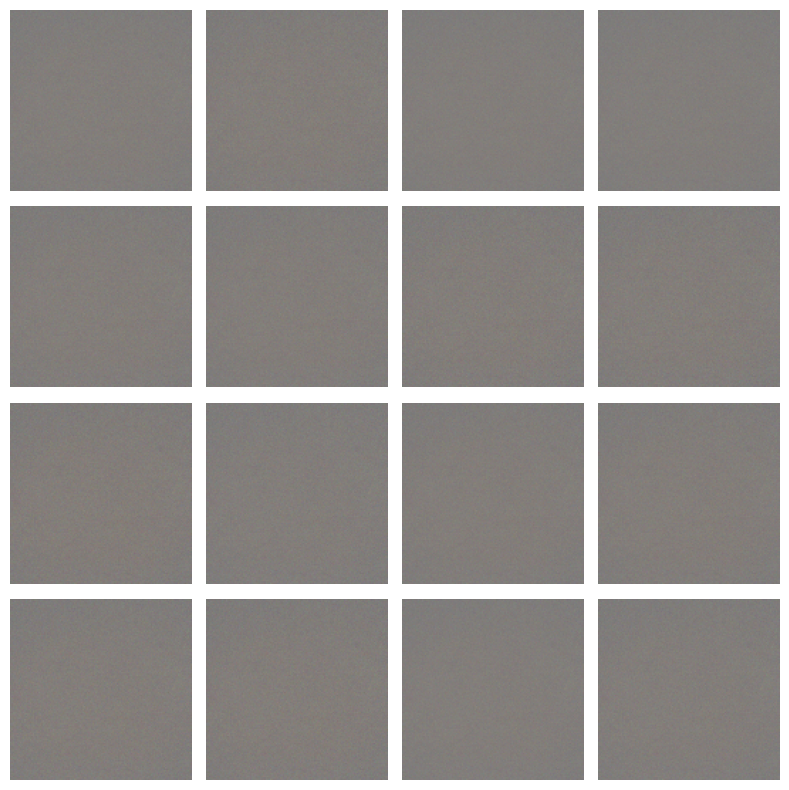

[Epoch 22/300] [Batch 0] D: 0.4800 G: 488.6147 Real mean: -0.1368 Fake mean: -0.0139
[Epoch 23/300] [Batch 0] D: 0.4666 G: 511.0370 Real mean: -0.1354 Fake mean: -0.0139
[Epoch 24/300] [Batch 0] D: 0.4681 G: 478.9803 Real mean: -0.1327 Fake mean: -0.0146
[Epoch 25/300] [Batch 0] D: 2.7051 G: 3501.4934 Real mean: -0.1517 Fake mean: -0.0214
[Epoch 26/300] [Batch 0] D: 0.5373 G: 2095.9817 Real mean: -0.1512 Fake mean: -0.0380
[Epoch 27/300] [Batch 0] D: 0.5152 G: 1933.9617 Real mean: -0.1941 Fake mean: -0.0138
[Epoch 28/300] [Batch 0] D: 0.4810 G: 1215.1379 Real mean: -0.1322 Fake mean: -0.0086
[Epoch 29/300] [Batch 0] D: 0.4847 G: 1297.9254 Real mean: -0.1235 Fake mean: -0.0059
[Epoch 30/300] [Batch 0] D: 0.4706 G: 1231.4640 Real mean: -0.1340 Fake mean: -0.0042
[Epoch 31/300] [Batch 0] D: 0.4781 G: 1038.9258 Real mean: -0.1281 Fake mean: -0.0095
[Epoch 32/300] [Batch 0] D: 0.4765 G: 1111.5946 Real mean: -0.1268 Fake mean: -0.0175
[Epoch 33/300] [Batch 0] D: 0.4628 G: 865.4593 Real mean:

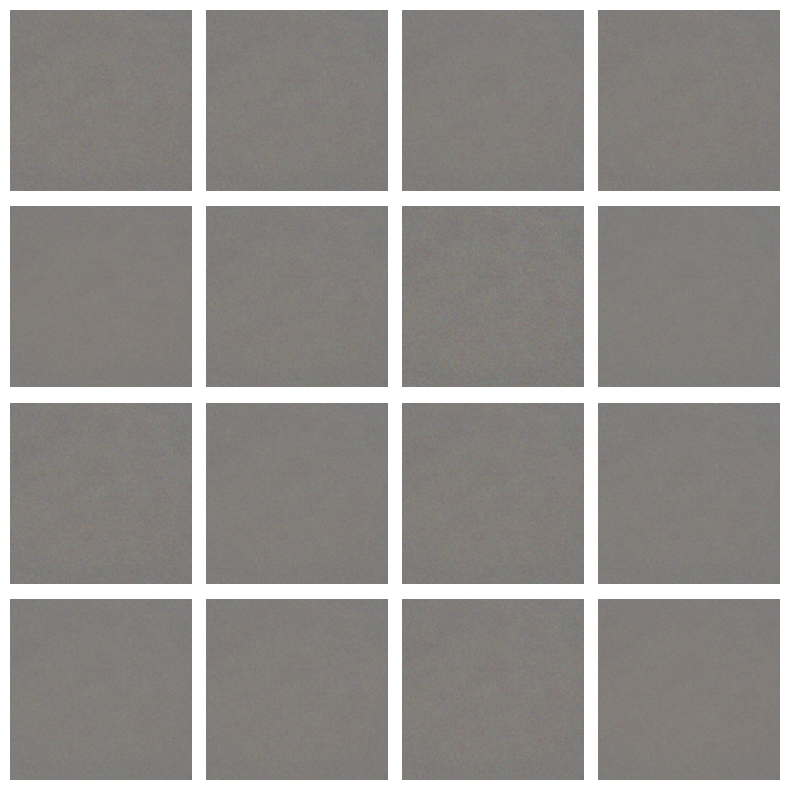

[Epoch 42/300] [Batch 0] D: 0.4229 G: 744.8340 Real mean: -0.1570 Fake mean: -0.0154
[Epoch 43/300] [Batch 0] D: 0.4194 G: 665.3273 Real mean: -0.1544 Fake mean: -0.0122
[Epoch 44/300] [Batch 0] D: 0.4309 G: 660.5051 Real mean: -0.1790 Fake mean: -0.0110
[Epoch 45/300] [Batch 0] D: 0.4209 G: 648.4385 Real mean: -0.1779 Fake mean: -0.0056
[Epoch 46/300] [Batch 0] D: 0.4408 G: 565.5436 Real mean: -0.1492 Fake mean: -0.0014
[Epoch 47/300] [Batch 0] D: 0.4047 G: 592.0319 Real mean: -0.1272 Fake mean: -0.0060
[Epoch 48/300] [Batch 0] D: 0.4111 G: 575.8448 Real mean: -0.1402 Fake mean: -0.0145
[Epoch 49/300] [Batch 0] D: 0.4784 G: 845.1445 Real mean: -0.1603 Fake mean: -0.0292
[Epoch 50/300] [Batch 0] D: 0.4337 G: 844.8769 Real mean: -0.1147 Fake mean: -0.0250
[Epoch 51/300] [Batch 0] D: 0.4312 G: 873.3862 Real mean: -0.2001 Fake mean: -0.0222
[Epoch 52/300] [Batch 0] D: 0.4222 G: 1053.2916 Real mean: -0.0966 Fake mean: -0.0172
[Epoch 53/300] [Batch 0] D: 0.5317 G: 1055.1177 Real mean: -0.15

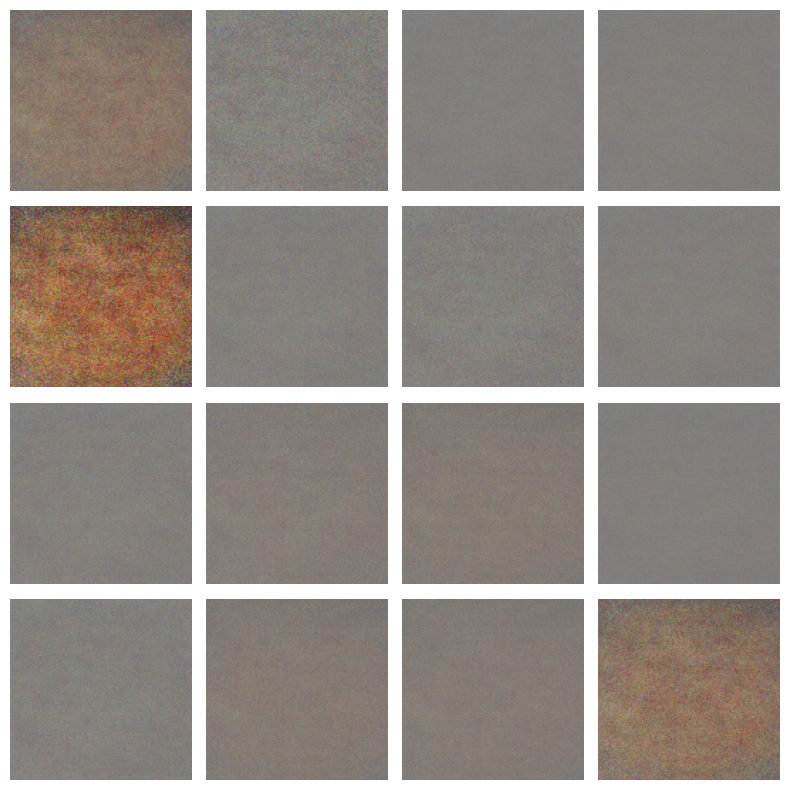

[Epoch 62/300] [Batch 0] D: 0.4313 G: 1086.3593 Real mean: -0.1180 Fake mean: -0.0218
[Epoch 63/300] [Batch 0] D: 0.3975 G: 1014.7388 Real mean: -0.1785 Fake mean: -0.0351
[Epoch 64/300] [Batch 0] D: 0.4619 G: 961.8832 Real mean: -0.1501 Fake mean: -0.0331
[Epoch 65/300] [Batch 0] D: 0.4344 G: 1030.5625 Real mean: -0.1698 Fake mean: -0.0275
[Epoch 66/300] [Batch 0] D: 0.4424 G: 1043.6670 Real mean: -0.1016 Fake mean: -0.0271
[Epoch 67/300] [Batch 0] D: 0.4129 G: 1027.8403 Real mean: -0.1313 Fake mean: -0.0358
[Epoch 68/300] [Batch 0] D: 0.4144 G: 1103.3173 Real mean: -0.1618 Fake mean: -0.0296
[Epoch 69/300] [Batch 0] D: 0.4640 G: 1196.0005 Real mean: -0.1763 Fake mean: -0.0300
[Epoch 70/300] [Batch 0] D: 0.4240 G: 954.5057 Real mean: -0.1517 Fake mean: -0.0222
[Epoch 71/300] [Batch 0] D: 0.3859 G: 953.3727 Real mean: -0.1388 Fake mean: -0.0308
[Epoch 72/300] [Batch 0] D: 0.4202 G: 844.7930 Real mean: -0.1127 Fake mean: -0.0540
[Epoch 73/300] [Batch 0] D: 0.4142 G: 829.8153 Real mean: 

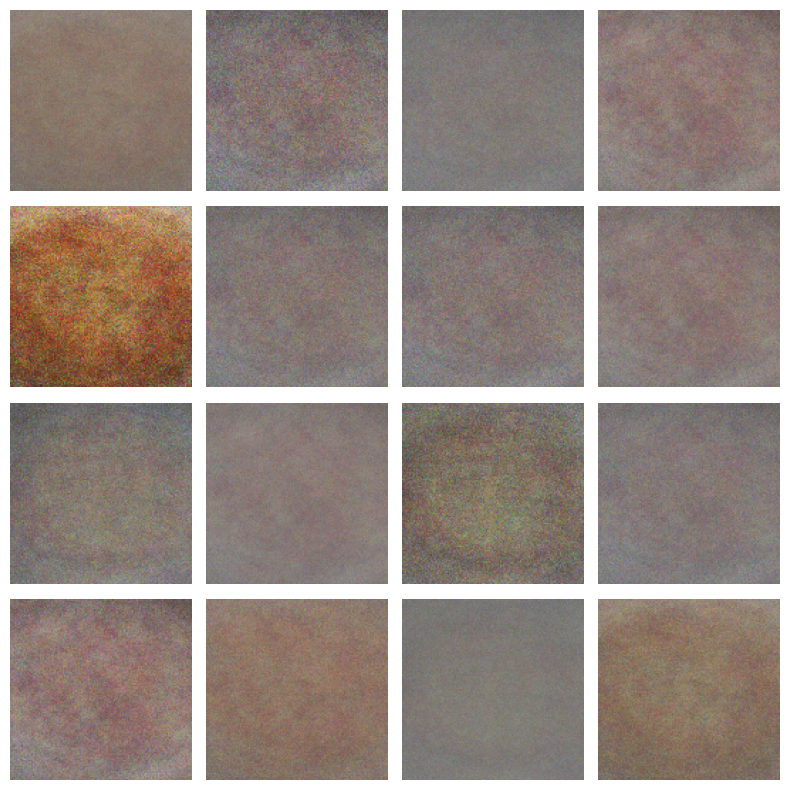

[Epoch 82/300] [Batch 0] D: 0.5010 G: 945.0309 Real mean: -0.1573 Fake mean: -0.0490
[Epoch 83/300] [Batch 0] D: 0.4309 G: 1072.8759 Real mean: -0.1562 Fake mean: -0.0548
[Epoch 84/300] [Batch 0] D: 0.4239 G: 1086.6503 Real mean: -0.1544 Fake mean: -0.0568
[Epoch 85/300] [Batch 0] D: 0.4429 G: 1186.8430 Real mean: -0.1737 Fake mean: -0.0457
[Epoch 86/300] [Batch 0] D: 0.4788 G: 984.4871 Real mean: -0.1221 Fake mean: -0.0467
[Epoch 87/300] [Batch 0] D: 0.4596 G: 1262.2815 Real mean: -0.1604 Fake mean: -0.0433
[Epoch 88/300] [Batch 0] D: 0.4208 G: 1206.9584 Real mean: -0.1752 Fake mean: -0.0554
[Epoch 89/300] [Batch 0] D: 0.4311 G: 1018.9756 Real mean: -0.1060 Fake mean: -0.0564
[Epoch 90/300] [Batch 0] D: 0.4237 G: 1052.3347 Real mean: -0.1398 Fake mean: -0.0541
[Epoch 91/300] [Batch 0] D: 0.4890 G: 909.2306 Real mean: -0.1446 Fake mean: -0.0527
[Epoch 92/300] [Batch 0] D: 0.4695 G: 1004.6534 Real mean: -0.1410 Fake mean: -0.0483
[Epoch 93/300] [Batch 0] D: 0.4105 G: 1000.5618 Real mean

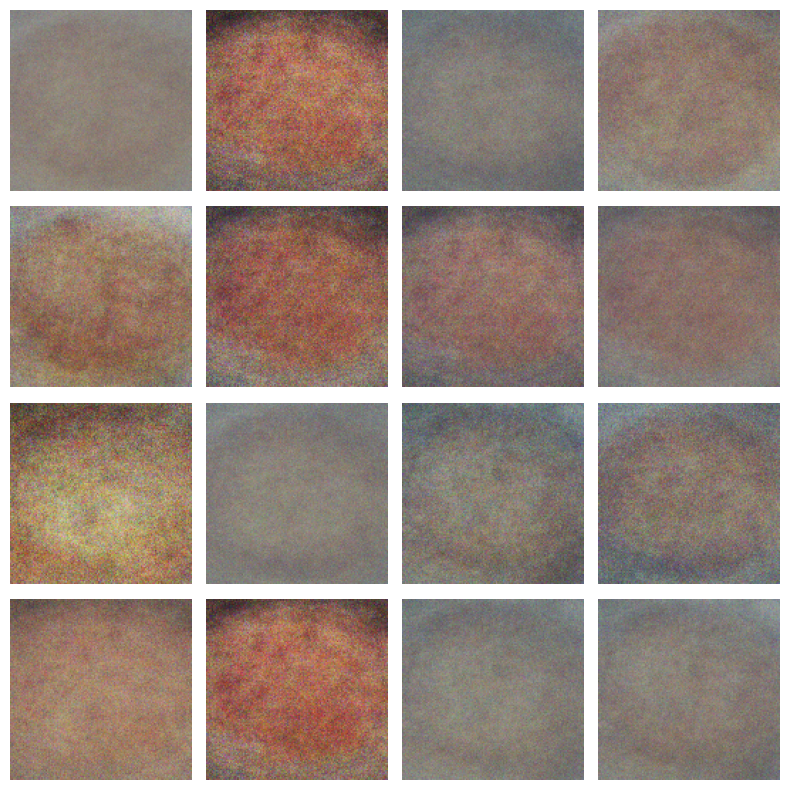

[Epoch 102/300] [Batch 0] D: 0.4080 G: 1078.8643 Real mean: -0.1421 Fake mean: -0.0528
[Epoch 103/300] [Batch 0] D: 0.4623 G: 1225.5408 Real mean: -0.1349 Fake mean: -0.0421
[Epoch 104/300] [Batch 0] D: 0.4448 G: 1027.9825 Real mean: -0.1485 Fake mean: -0.0587
[Epoch 105/300] [Batch 0] D: 0.4581 G: 1024.3772 Real mean: -0.1693 Fake mean: -0.0510
[Epoch 106/300] [Batch 0] D: 0.4751 G: 1175.6522 Real mean: -0.1389 Fake mean: -0.0376
[Epoch 107/300] [Batch 0] D: 0.4570 G: 1038.6969 Real mean: -0.1595 Fake mean: -0.0591
[Epoch 108/300] [Batch 0] D: 0.4565 G: 1349.6238 Real mean: -0.1231 Fake mean: -0.0441
[Epoch 109/300] [Batch 0] D: 0.4690 G: 1082.8090 Real mean: -0.1226 Fake mean: -0.0845
[Epoch 110/300] [Batch 0] D: 0.4450 G: 1215.8641 Real mean: -0.1580 Fake mean: -0.0868
[Epoch 111/300] [Batch 0] D: 0.4414 G: 1168.0640 Real mean: -0.1173 Fake mean: -0.0792
[Epoch 112/300] [Batch 0] D: 0.4453 G: 1181.7419 Real mean: -0.1640 Fake mean: -0.0735
[Epoch 113/300] [Batch 0] D: 0.4671 G: 1018

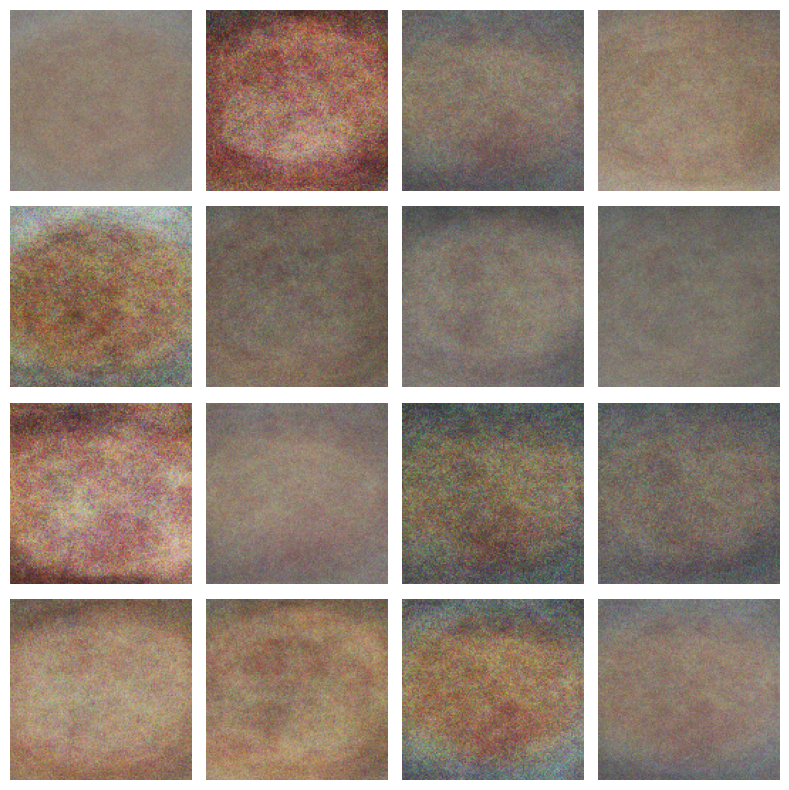

[Epoch 122/300] [Batch 0] D: 0.5146 G: 1094.8008 Real mean: -0.1374 Fake mean: -0.0628
[Epoch 123/300] [Batch 0] D: 0.4895 G: 1207.5323 Real mean: -0.1334 Fake mean: -0.0940
[Epoch 124/300] [Batch 0] D: 0.4945 G: 1199.1941 Real mean: -0.1572 Fake mean: -0.0875
[Epoch 125/300] [Batch 0] D: 0.5016 G: 1200.8610 Real mean: -0.1296 Fake mean: -0.0953
[Epoch 126/300] [Batch 0] D: 0.4593 G: 1224.3265 Real mean: -0.1518 Fake mean: -0.0720
[Epoch 127/300] [Batch 0] D: 0.4464 G: 1153.8708 Real mean: -0.1244 Fake mean: -0.0645
[Epoch 128/300] [Batch 0] D: 0.4586 G: 1231.1210 Real mean: -0.0869 Fake mean: -0.0926
[Epoch 129/300] [Batch 0] D: 0.4918 G: 1299.8834 Real mean: -0.1200 Fake mean: -0.0880
[Epoch 130/300] [Batch 0] D: 0.4656 G: 1337.3203 Real mean: -0.0942 Fake mean: -0.0803
[Epoch 131/300] [Batch 0] D: 0.5082 G: 1386.8385 Real mean: -0.1301 Fake mean: -0.0889
[Epoch 132/300] [Batch 0] D: 0.4819 G: 1280.9152 Real mean: -0.1215 Fake mean: -0.0920
[Epoch 133/300] [Batch 0] D: 0.4427 G: 1319

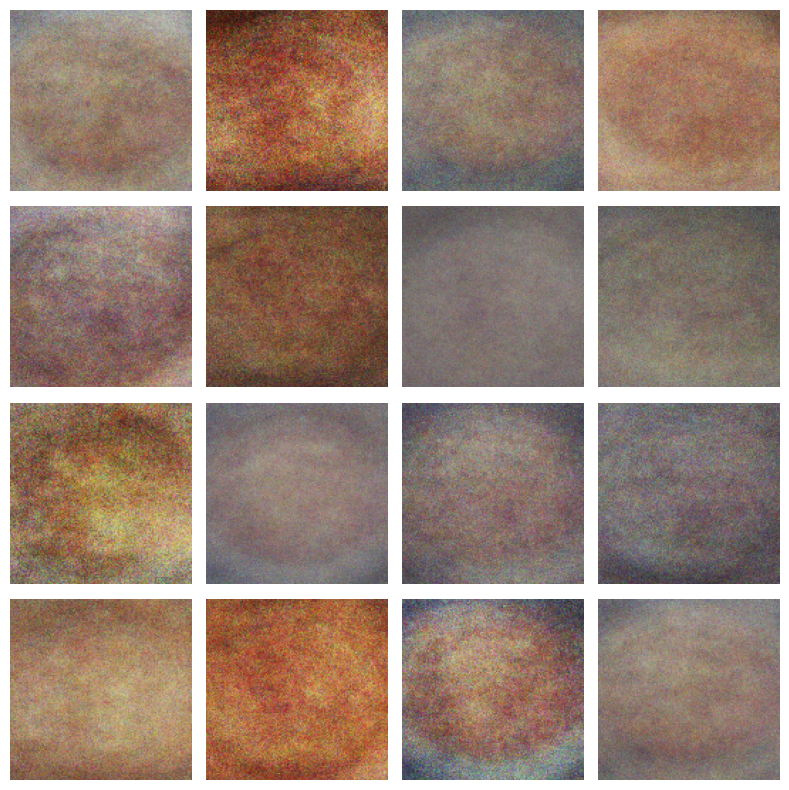

[Epoch 142/300] [Batch 0] D: 0.5384 G: 1359.1296 Real mean: -0.1602 Fake mean: -0.0911
[Epoch 143/300] [Batch 0] D: 0.4636 G: 1510.4049 Real mean: -0.1600 Fake mean: -0.0913
[Epoch 144/300] [Batch 0] D: 0.4456 G: 1576.6626 Real mean: -0.1161 Fake mean: -0.0962
[Epoch 145/300] [Batch 0] D: 0.4730 G: 1516.6981 Real mean: -0.1526 Fake mean: -0.1015
[Epoch 146/300] [Batch 0] D: 0.4751 G: 1421.3784 Real mean: -0.1555 Fake mean: -0.0714
[Epoch 147/300] [Batch 0] D: 0.4627 G: 1327.4196 Real mean: -0.1562 Fake mean: -0.0657
[Epoch 148/300] [Batch 0] D: 0.4700 G: 1383.6318 Real mean: -0.1419 Fake mean: -0.1218
[Epoch 149/300] [Batch 0] D: 0.5584 G: 1429.9385 Real mean: -0.1834 Fake mean: -0.0989
[Epoch 150/300] [Batch 0] D: 0.4823 G: 1532.1171 Real mean: -0.1169 Fake mean: -0.1121
[Epoch 151/300] [Batch 0] D: 0.4653 G: 1419.6617 Real mean: -0.1276 Fake mean: -0.0994
[Epoch 152/300] [Batch 0] D: 0.5258 G: 1535.2609 Real mean: -0.1283 Fake mean: -0.0983
[Epoch 153/300] [Batch 0] D: 0.4654 G: 1364

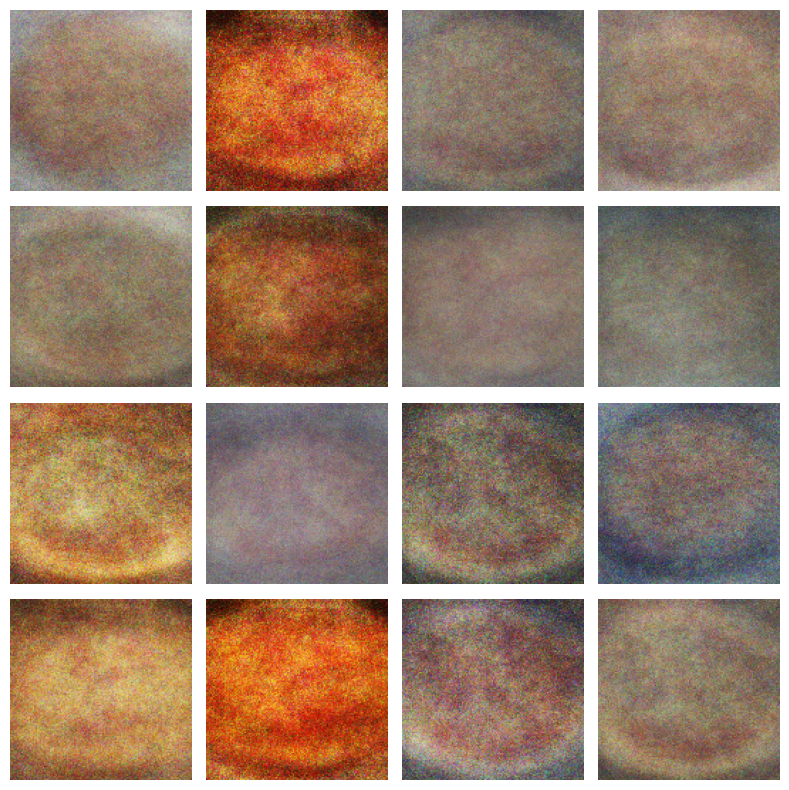

[Epoch 162/300] [Batch 0] D: 0.4575 G: 1695.1611 Real mean: -0.1487 Fake mean: -0.1035
[Epoch 163/300] [Batch 0] D: 0.4997 G: 1719.2554 Real mean: -0.1799 Fake mean: -0.1027
[Epoch 164/300] [Batch 0] D: 0.4903 G: 1565.5773 Real mean: -0.1779 Fake mean: -0.0894
[Epoch 165/300] [Batch 0] D: 0.5524 G: 1691.0328 Real mean: -0.1263 Fake mean: -0.1164
[Epoch 166/300] [Batch 0] D: 0.4913 G: 1557.0940 Real mean: -0.1657 Fake mean: -0.1175
[Epoch 167/300] [Batch 0] D: 0.5306 G: 1461.8591 Real mean: -0.1436 Fake mean: -0.0797
[Epoch 168/300] [Batch 0] D: 0.4511 G: 2000.6538 Real mean: -0.1153 Fake mean: -0.0959
[Epoch 169/300] [Batch 0] D: 0.6438 G: 1513.7448 Real mean: -0.1446 Fake mean: -0.0893
[Epoch 170/300] [Batch 0] D: 0.5110 G: 1780.6842 Real mean: -0.1506 Fake mean: -0.1198
[Epoch 171/300] [Batch 0] D: 0.6196 G: 1653.3528 Real mean: -0.1535 Fake mean: -0.1306
[Epoch 172/300] [Batch 0] D: 0.4629 G: 1636.7402 Real mean: -0.1428 Fake mean: -0.1161
[Epoch 173/300] [Batch 0] D: 0.4639 G: 1795

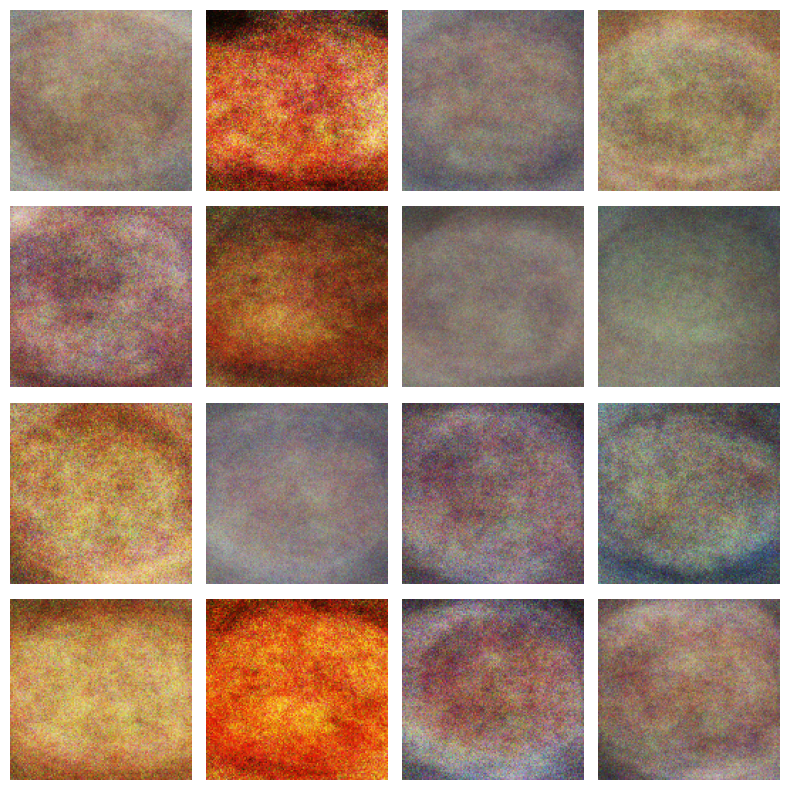

[Epoch 182/300] [Batch 0] D: 0.4632 G: 1971.3977 Real mean: -0.1197 Fake mean: -0.0652
[Epoch 183/300] [Batch 0] D: 0.4936 G: 1919.1304 Real mean: -0.1439 Fake mean: -0.1133
[Epoch 184/300] [Batch 0] D: 0.4673 G: 1958.2985 Real mean: -0.1245 Fake mean: -0.1203
[Epoch 185/300] [Batch 0] D: 0.4942 G: 1906.3286 Real mean: -0.1643 Fake mean: -0.1052
[Epoch 186/300] [Batch 0] D: 0.5356 G: 1804.1520 Real mean: -0.1584 Fake mean: -0.1040
[Epoch 187/300] [Batch 0] D: 0.4999 G: 1821.5073 Real mean: -0.1434 Fake mean: -0.1051
[Epoch 188/300] [Batch 0] D: 0.4618 G: 1969.7855 Real mean: -0.1499 Fake mean: -0.1015
[Epoch 189/300] [Batch 0] D: 0.4597 G: 1984.2965 Real mean: -0.1233 Fake mean: -0.1046
[Epoch 190/300] [Batch 0] D: 0.4727 G: 1884.4828 Real mean: -0.1176 Fake mean: -0.1108
[Epoch 191/300] [Batch 0] D: 0.5050 G: 1892.3068 Real mean: -0.1264 Fake mean: -0.1081
[Epoch 192/300] [Batch 0] D: 0.4889 G: 2058.8000 Real mean: -0.1294 Fake mean: -0.1093
[Epoch 193/300] [Batch 0] D: 0.5104 G: 1915

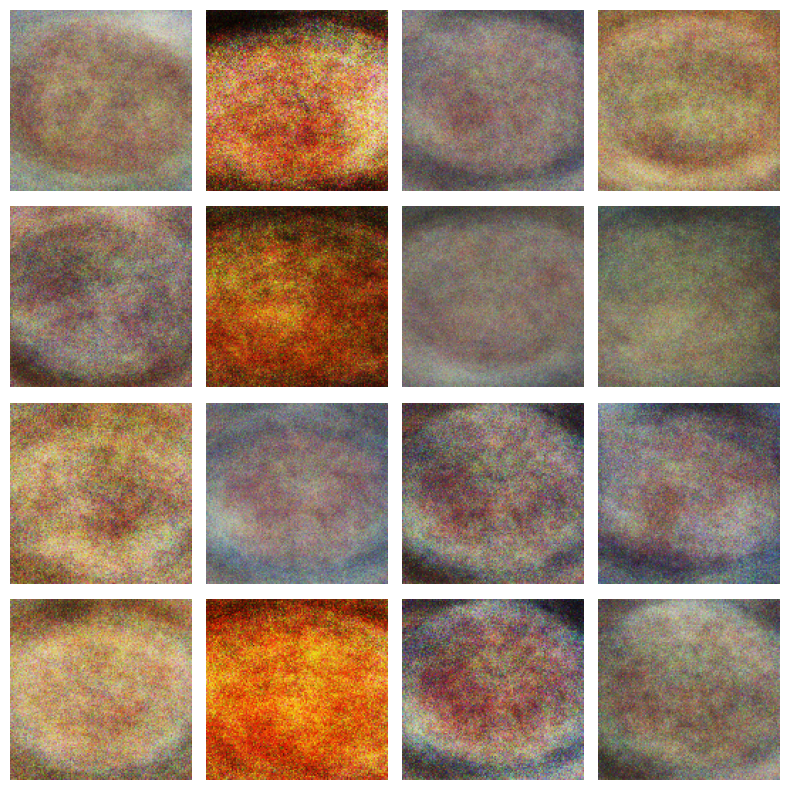

[Epoch 202/300] [Batch 0] D: 0.4898 G: 2187.5012 Real mean: -0.1345 Fake mean: -0.1072
[Epoch 203/300] [Batch 0] D: 0.4633 G: 2066.2527 Real mean: -0.1710 Fake mean: -0.1184
[Epoch 204/300] [Batch 0] D: 0.4951 G: 2027.7126 Real mean: -0.1599 Fake mean: -0.1127
[Epoch 205/300] [Batch 0] D: 0.6195 G: 2271.9656 Real mean: -0.1492 Fake mean: -0.1149
[Epoch 206/300] [Batch 0] D: 0.5134 G: 1924.1211 Real mean: -0.1497 Fake mean: -0.1188
[Epoch 207/300] [Batch 0] D: 0.4905 G: 2040.2526 Real mean: -0.1088 Fake mean: -0.1479
[Epoch 208/300] [Batch 0] D: 0.4916 G: 2026.1415 Real mean: -0.1376 Fake mean: -0.1384
[Epoch 209/300] [Batch 0] D: 0.5162 G: 2277.9736 Real mean: -0.1446 Fake mean: -0.1051
[Epoch 210/300] [Batch 0] D: 0.4943 G: 1908.0837 Real mean: -0.1723 Fake mean: -0.1054
[Epoch 211/300] [Batch 0] D: 0.4818 G: 2267.3997 Real mean: -0.1171 Fake mean: -0.0965
[Epoch 212/300] [Batch 0] D: 0.6108 G: 2170.1230 Real mean: -0.1188 Fake mean: -0.1528
[Epoch 213/300] [Batch 0] D: 0.4847 G: 1890

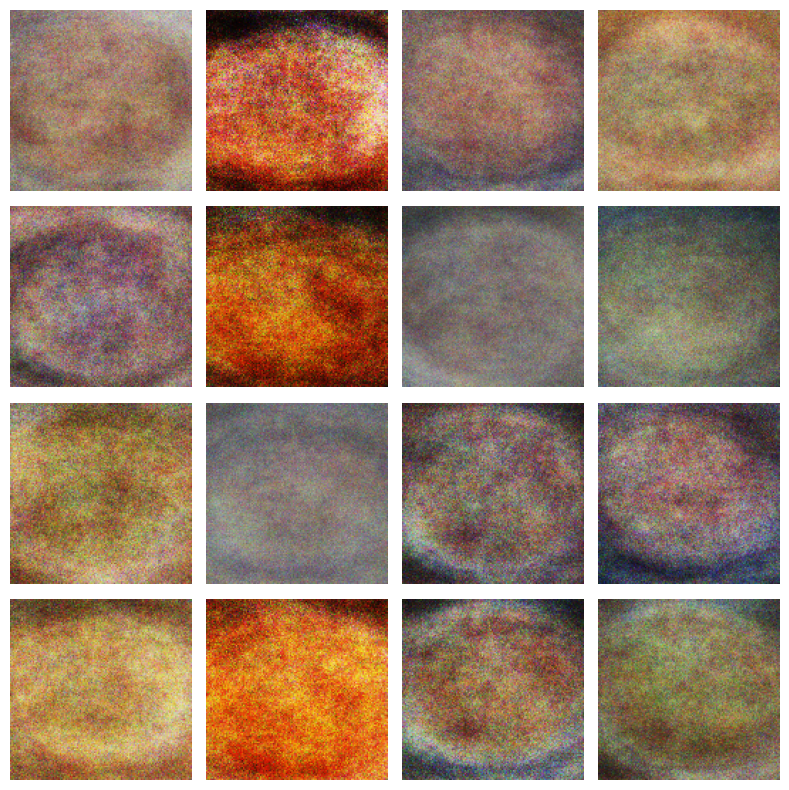

[Epoch 222/300] [Batch 0] D: 0.4519 G: 2257.6448 Real mean: -0.1692 Fake mean: -0.1533
[Epoch 223/300] [Batch 0] D: 0.5071 G: 2356.4900 Real mean: -0.1427 Fake mean: -0.1222
[Epoch 224/300] [Batch 0] D: 0.4598 G: 2201.5803 Real mean: -0.1269 Fake mean: -0.1223
[Epoch 225/300] [Batch 0] D: 0.4859 G: 2403.8745 Real mean: -0.1548 Fake mean: -0.1349
[Epoch 226/300] [Batch 0] D: 0.5191 G: 2347.9172 Real mean: -0.1015 Fake mean: -0.1461
[Epoch 227/300] [Batch 0] D: 0.5372 G: 2411.9158 Real mean: -0.1400 Fake mean: -0.1245
[Epoch 228/300] [Batch 0] D: 0.4937 G: 2333.1387 Real mean: -0.1249 Fake mean: -0.1601
[Epoch 229/300] [Batch 0] D: 0.4943 G: 2368.3369 Real mean: -0.1615 Fake mean: -0.1507
[Epoch 230/300] [Batch 0] D: 0.5003 G: 2173.7935 Real mean: -0.1742 Fake mean: -0.1256
[Epoch 231/300] [Batch 0] D: 0.5011 G: 2316.0046 Real mean: -0.0865 Fake mean: -0.1145
[Epoch 232/300] [Batch 0] D: 0.4989 G: 2113.5259 Real mean: -0.1183 Fake mean: -0.1313
[Epoch 233/300] [Batch 0] D: 0.4512 G: 2493

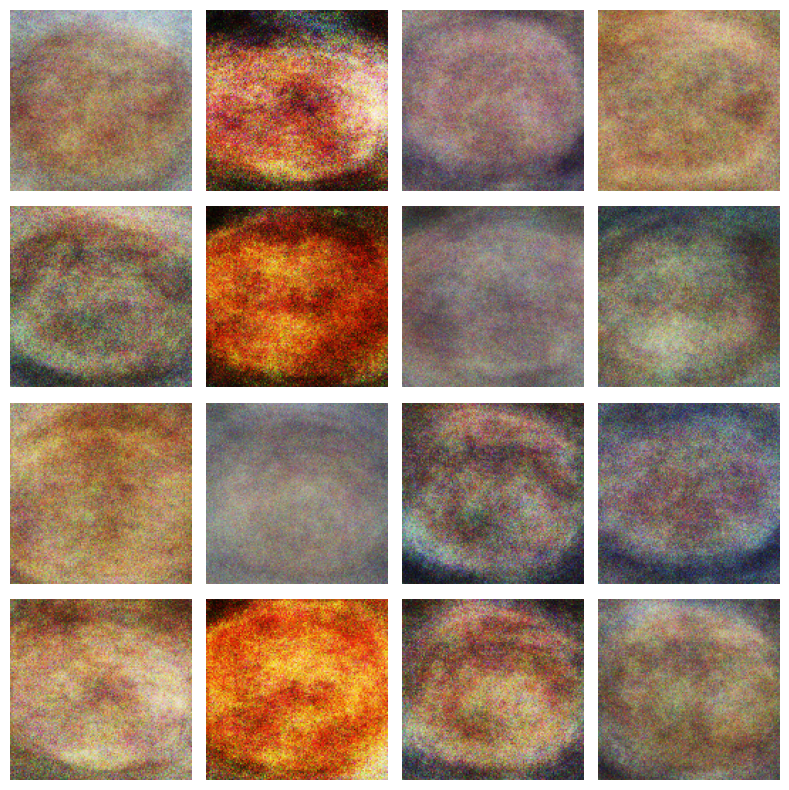

[Epoch 242/300] [Batch 0] D: 0.5131 G: 2234.4041 Real mean: -0.1301 Fake mean: -0.1634
[Epoch 243/300] [Batch 0] D: 0.5242 G: 2411.3794 Real mean: -0.1543 Fake mean: -0.1286
[Epoch 244/300] [Batch 0] D: 0.5680 G: 2294.7039 Real mean: -0.1551 Fake mean: -0.1479
[Epoch 245/300] [Batch 0] D: 0.4905 G: 2464.3677 Real mean: -0.0970 Fake mean: -0.1393
[Epoch 246/300] [Batch 0] D: 0.4686 G: 2525.6770 Real mean: -0.1456 Fake mean: -0.1329
[Epoch 247/300] [Batch 0] D: 0.5392 G: 2369.7581 Real mean: -0.1612 Fake mean: -0.1176
[Epoch 248/300] [Batch 0] D: 0.5014 G: 2460.4233 Real mean: -0.1213 Fake mean: -0.1439
[Epoch 249/300] [Batch 0] D: 0.4710 G: 2602.9790 Real mean: -0.1326 Fake mean: -0.1499
[Epoch 250/300] [Batch 0] D: 0.5316 G: 2844.3950 Real mean: -0.1733 Fake mean: -0.1490
[Epoch 251/300] [Batch 0] D: 0.5492 G: 2473.1536 Real mean: -0.1537 Fake mean: -0.0974
[Epoch 252/300] [Batch 0] D: 0.5297 G: 2881.4924 Real mean: -0.1322 Fake mean: -0.1490
[Epoch 253/300] [Batch 0] D: 0.5070 G: 2735

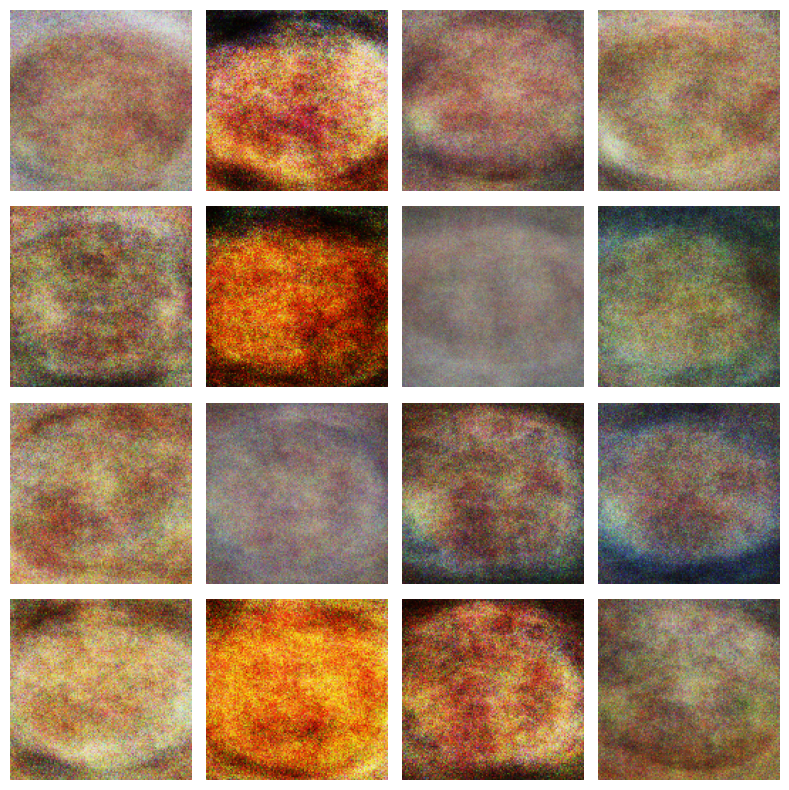

[Epoch 262/300] [Batch 0] D: 0.5448 G: 2429.8608 Real mean: -0.1422 Fake mean: -0.1165
[Epoch 263/300] [Batch 0] D: 0.5269 G: 2597.9333 Real mean: -0.1310 Fake mean: -0.1124
[Epoch 264/300] [Batch 0] D: 0.5376 G: 2821.6145 Real mean: -0.1009 Fake mean: -0.1156
[Epoch 265/300] [Batch 0] D: 0.4863 G: 2556.4912 Real mean: -0.1467 Fake mean: -0.1545
[Epoch 266/300] [Batch 0] D: 0.5035 G: 2746.0569 Real mean: -0.1277 Fake mean: -0.1753
[Epoch 267/300] [Batch 0] D: 0.5018 G: 2710.7097 Real mean: -0.1101 Fake mean: -0.0921
[Epoch 268/300] [Batch 0] D: 0.5359 G: 2661.0415 Real mean: -0.1299 Fake mean: -0.1447
[Epoch 269/300] [Batch 0] D: 0.5151 G: 2506.0601 Real mean: -0.1579 Fake mean: -0.1559
[Epoch 270/300] [Batch 0] D: 0.4908 G: 2805.0669 Real mean: -0.0790 Fake mean: -0.1801
[Epoch 271/300] [Batch 0] D: 0.4767 G: 2694.5542 Real mean: -0.1569 Fake mean: -0.0833
[Epoch 272/300] [Batch 0] D: 0.4955 G: 3023.7795 Real mean: -0.1240 Fake mean: -0.1461
[Epoch 273/300] [Batch 0] D: 0.5051 G: 2957

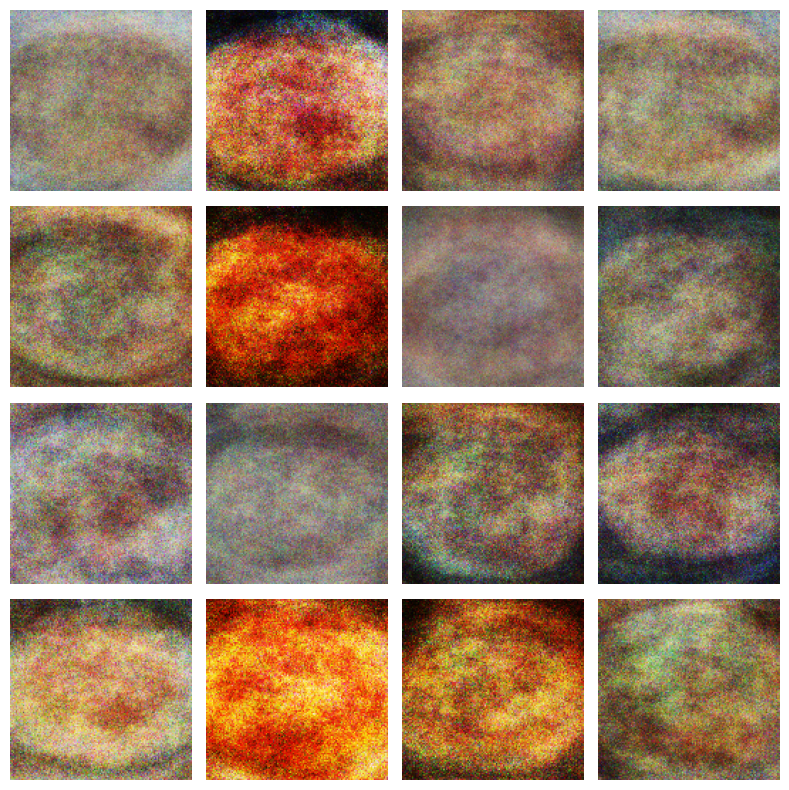

[Epoch 282/300] [Batch 0] D: 0.4990 G: 3002.4084 Real mean: -0.1649 Fake mean: -0.1392
[Epoch 283/300] [Batch 0] D: 0.4610 G: 2805.1213 Real mean: -0.1326 Fake mean: -0.1551
[Epoch 284/300] [Batch 0] D: 0.5214 G: 2721.4597 Real mean: -0.1586 Fake mean: -0.1707
[Epoch 285/300] [Batch 0] D: 0.5043 G: 2832.3030 Real mean: -0.1434 Fake mean: -0.1764
[Epoch 286/300] [Batch 0] D: 0.5078 G: 2605.9932 Real mean: -0.1706 Fake mean: -0.1913
[Epoch 287/300] [Batch 0] D: 0.5043 G: 3051.4001 Real mean: -0.1252 Fake mean: -0.1388
[Epoch 288/300] [Batch 0] D: 0.5168 G: 3310.0835 Real mean: -0.1177 Fake mean: -0.1671
[Epoch 289/300] [Batch 0] D: 0.4599 G: 3123.5955 Real mean: -0.1147 Fake mean: -0.1714
[Epoch 290/300] [Batch 0] D: 0.4897 G: 3003.1648 Real mean: -0.1477 Fake mean: -0.1385
[Epoch 291/300] [Batch 0] D: 0.5374 G: 3075.7505 Real mean: -0.1237 Fake mean: -0.1720
[Epoch 292/300] [Batch 0] D: 0.5306 G: 3078.8723 Real mean: -0.1659 Fake mean: -0.1344
[Epoch 293/300] [Batch 0] D: 0.5190 G: 3328

In [10]:
d_losses = []
g_losses = []

for epoch in range(num_epochs):
    for i, real_imgs in enumerate(dataloader):
        real_imgs = real_imgs.to(device).view(batch_size, -1)
        valid = torch.full((batch_size, 1), 0.9, device=device)  # Smoothing
        fake_label = torch.full((batch_size, 1), 0.1, device=device)

        #D 
        z = torch.randn(batch_size, latent_dim, device=device)
        fake_imgs = generator(z)

        real_loss = criterion(discriminator(real_imgs), valid)
        fake_loss = criterion(discriminator(fake_imgs.detach()), fake_label)
        d_loss = (real_loss + fake_loss) / 2

        optimizer_D.zero_grad()
        d_loss.backward()
        optimizer_D.step()

        #G
        fake_imgs = generator(z)
        bce_g_loss = criterion(discriminator(fake_imgs), valid)

        feat_real = discriminator[0:3](real_imgs)
        feat_fake = discriminator[0:3](fake_imgs)
        fm_loss = F.mse_loss(feat_real, feat_fake.detach())

        g_loss = bce_g_loss + 10 * fm_loss

        optimizer_G.zero_grad()
        g_loss.backward()
        optimizer_G.step()

        d_losses.append(d_loss.item())
        g_losses.append(g_loss.item())

        if i % 200 == 0:
            print(f"[Epoch {epoch+1}/{num_epochs}] [Batch {i}] "
                  f"D: {d_loss:.4f} G: {g_loss:.4f} "
                  f"Real mean: {real_imgs.mean():.4f} Fake mean: {fake_imgs.mean():.4f}")

    if epoch % 20 == 0:
        print(f"Epoch {epoch+1} samples:")
        generate_and_show(generator, fixed_z)
        torch.save(generator.state_dict(), f'generator_epoch_{epoch+1}.pth')


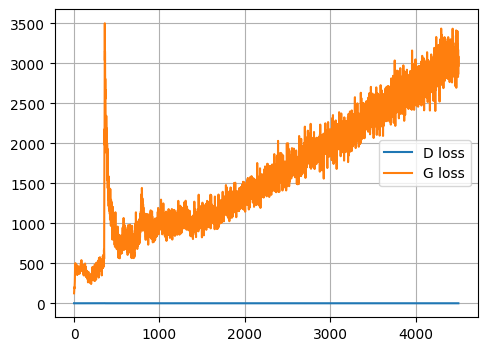

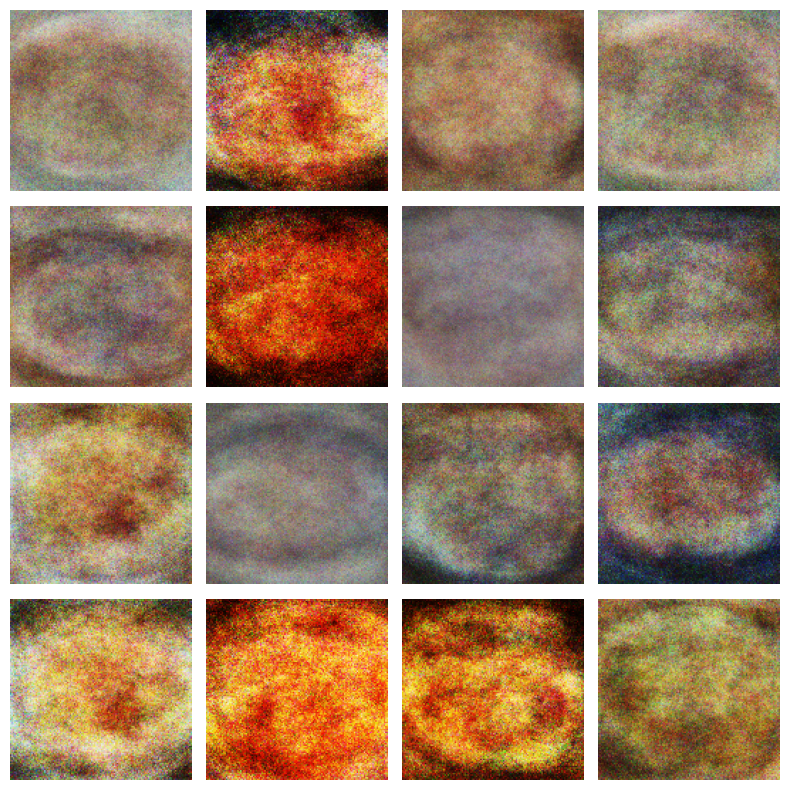

In [12]:
plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
plt.plot(d_losses, label='D loss')
plt.plot(g_losses, label='G loss')
plt.legend()
plt.grid()
plt.show()

generate_and_show(generator, fixed_z)